#### Breast Cancer

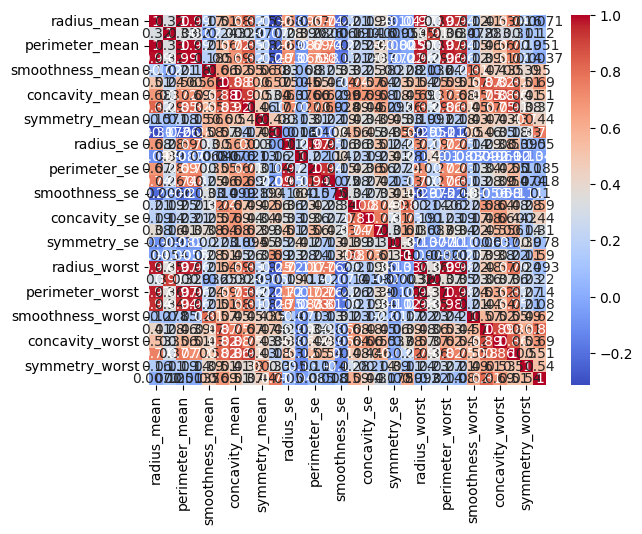

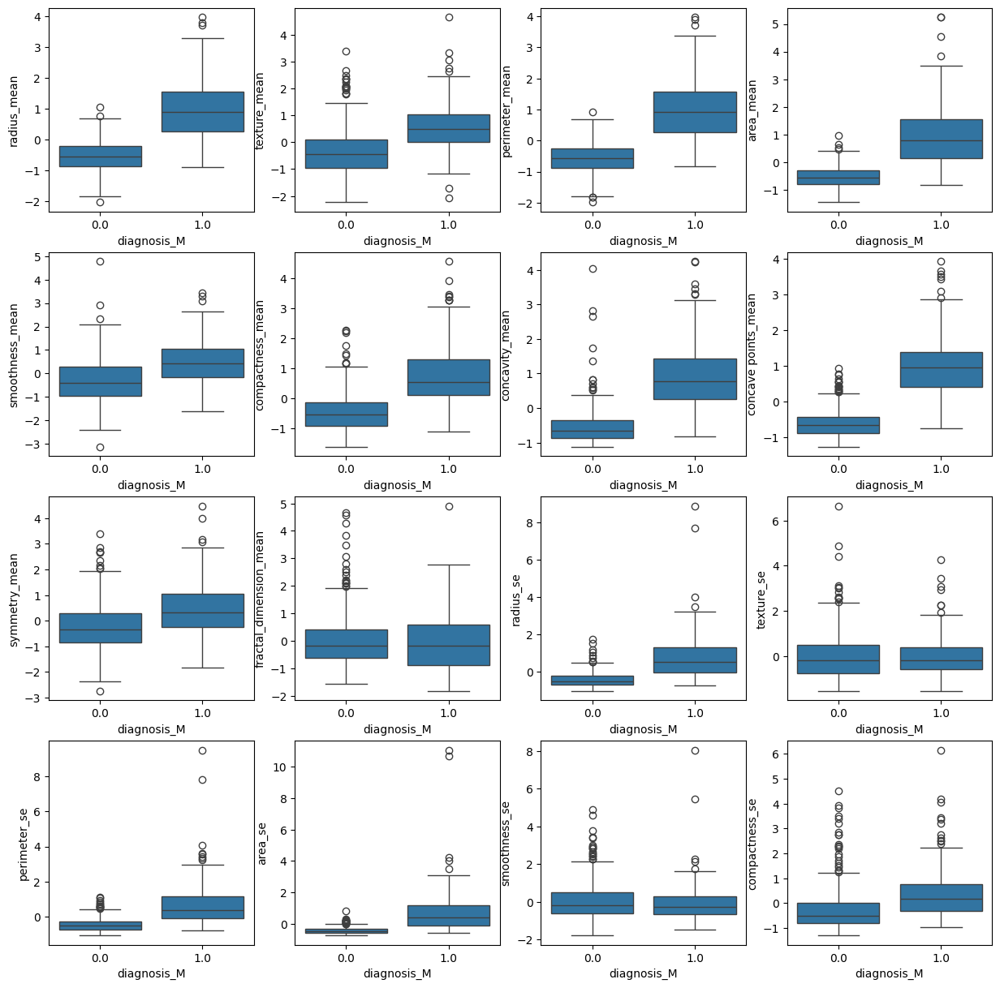

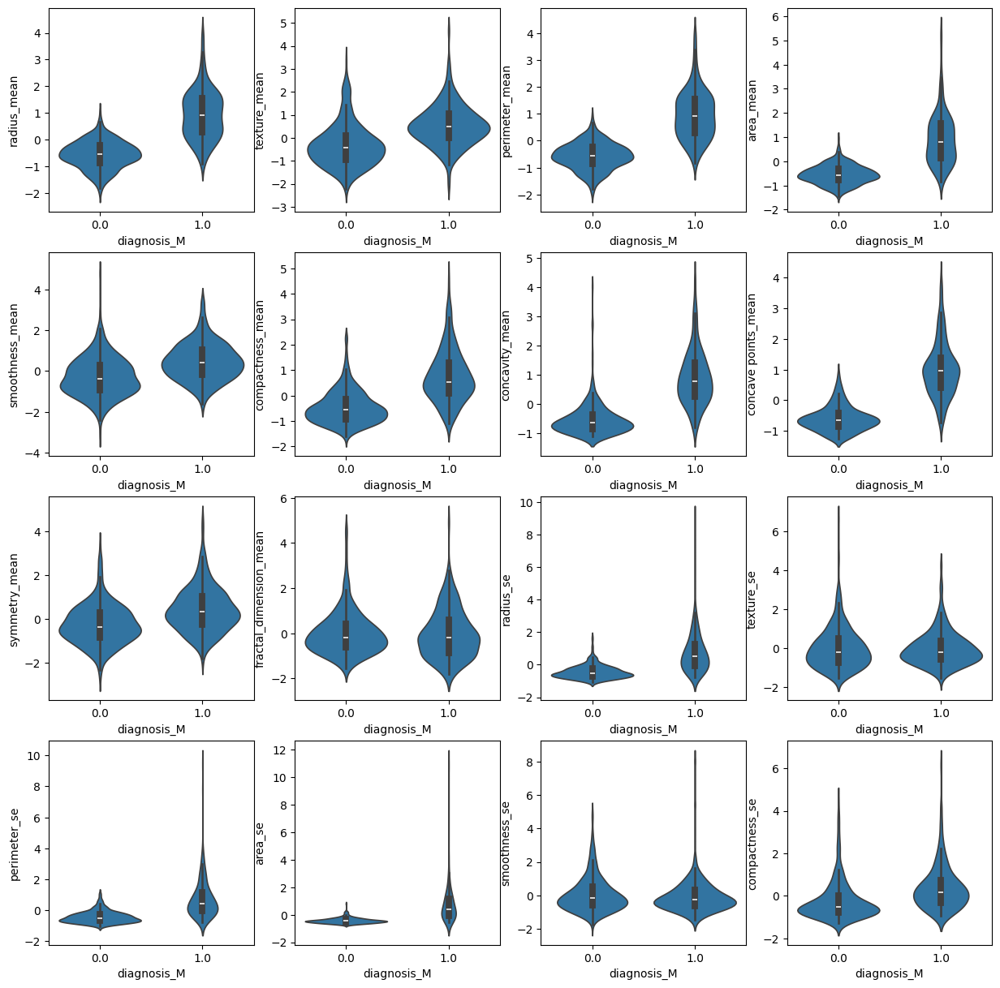

A violin plot is a combination of a box plot and a kernel density plot. It visually represents the distribution of data across different groups. The wider parts of the violin represent areas where there is a higher density of data points.
Possible outliers can be observed in some features based on the violin plots, especially in features with long tails or distinct peaks away from the main distribution.


In [14]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler, OneHotEncoder

# Load the data
data = pd.read_csv(r"C:\Users\justino\Downloads\data.csv")

# Handle missing values
data = data.dropna()

# Drop irrelevant columns
data = data.drop(['id'], axis=1)

# Separate features and target
features = data.drop(['diagnosis'], axis=1)
target = data['diagnosis']

# Scale the features
scaler = StandardScaler()
scaled_features = scaler.fit_transform(features)
scaled_features_df = pd.DataFrame(scaled_features, columns=features.columns)

# One-hot encode the target
encoder = OneHotEncoder() 
encoded_target = encoder.fit_transform(target.values.reshape(-1, 1)).toarray() 
encoded_target_df = pd.DataFrame(encoded_target, columns=['diagnosis_B', 'diagnosis_M'])


# Concatenate scaled features and encoded target
data_refined = pd.concat([scaled_features_df, encoded_target_df], axis=1)

# Pair plot with one-hot encoded target
sns.pairplot(data_refined, hue='diagnosis_M')  # Assuming 'diagnosis_M' represents malignant 
plt.show()

# Correlation matrix
corr_matrix = data_refined.drop(['diagnosis_B', 'diagnosis_M'], axis=1).corr() 
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.show()

# Box plots
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(15, 15))
for i, feature in enumerate(features.columns):
    row = i // 4  # Corrected row calculation
    col = i % 4 
    if i < 16:  # Check if the current index is within the range of subplots
        sns.boxplot(x='diagnosis_M', y=feature, data=data_refined, ax=axes[row, col])
plt.show()

# Violin plots
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(15, 15))
for i, feature in enumerate(features.columns):
    row = i // 4
    col = i % 4
    if i< 16:
        sns.violinplot(x='diagnosis_M', y=feature, data=data_refined, ax=axes[row, col])
plt.show()

# Violin Plot Description
print("A violin plot is a combination of a box plot and a kernel density plot. "
      "It visually represents the distribution of data across different groups. "
      "The wider parts of the violin represent areas where there is a higher density of data points.")

# Outlier Detection
print("Possible outliers can be observed in some features based on the violin plots, "
      "especially in features with long tails or distinct peaks away from the main distribution.")